# 衛星データの画像分類

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/RyoWakabayashi/elixir-learning/blob/main/colab/PyTorch_EfficientNetV2_TransferLearning.ipynb)

衛星データ（可視光による衛星写真）を以下の種類に分類する

- clear: 雲なし
- cloudy: 雲あり

## ONNX のインストール

In [1]:
!pip install onnx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 36.5 MB/s eta 0:00:00


## モジュールのインポート

In [2]:
import copy
import math
import os
import random
import time

import matplotlib.pyplot as plt
import numpy as np
import shutil
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision

from glob import glob
from google.colab import drive

from torchvision import datasets, models, transforms

## データの準備

Google Drive 上の space/dataset.zip にデータを配置しておく

https://sorabatake.jp/9442/

In [4]:
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
!cp /content/drive/MyDrive/space/dataset.zip .
!unzip dataset.zip

Archive:  dataset.zip
   creating: dataset/
  inflating: __MACOSX/._dataset      
  inflating: dataset/.DS_Store       
  inflating: __MACOSX/dataset/._.DS_Store  
   creating: dataset/test/
  inflating: __MACOSX/dataset/._test  
   creating: dataset/train/
  inflating: __MACOSX/dataset/._train  
   creating: dataset/validation/
  inflating: __MACOSX/dataset/._validation  
   creating: dataset/test/cloudy/
  inflating: __MACOSX/dataset/test/._cloudy  
  inflating: dataset/test/.DS_Store  
  inflating: __MACOSX/dataset/test/._.DS_Store  
   creating: dataset/test/clear/
  inflating: __MACOSX/dataset/test/._clear  
   creating: dataset/train/cloudy/
  inflating: __MACOSX/dataset/train/._cloudy  
  inflating: dataset/train/.DS_Store  
  inflating: __MACOSX/dataset/train/._.DS_Store  
   creating: dataset/train/clear/
  inflating: __MACOSX/dataset/train/._clear  
   creating: dataset/validation/cloudy/
  inflating: __MACOSX/dataset/validation/._cloudy  
  inflating: dataset/validation/.DS_

クラス名一覧を取得する

In [6]:
classes = [os.path.basename(directory) for directory in sorted(glob("./dataset/train/*"))]

classes

['clear', 'cloudy']

## モデル定義

EfficientNet V2 の ImageNet データセット学習済モデルを転移学習元とする

In [7]:
model = models.efficientnet_v2_m(weights=models.EfficientNet_V2_M_Weights.IMAGENET1K_V1)

Downloading: "https://download.pytorch.org/models/efficientnet_v2_m-dc08266a.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_m-dc08266a.pth
100%|██████████| 208M/208M [00:03<00:00, 55.8MB/s]


In [8]:
for param in model.parameters():
    param.requires_grad = False

In [9]:
model.classifier

Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1280, out_features=1000, bias=True)
)

出力層を2種類のクラス分類用に変更する

In [10]:
num_ftrs = model.classifier[1].in_features
model.classifier[1] = nn.Linear(num_ftrs, len(classes))

In [11]:
model.classifier

Sequential(
  (0): Dropout(p=0.3, inplace=True)
  (1): Linear(in_features=1280, out_features=2, bias=True)
)

## データロード定義

データの読み込み方を定義する

- EfficientNet V2 M の入力層に合わせた画像サイズに変換する
- トレーニングデータは水平・垂直反転、回転・移動・拡大・縮小、台形変換、明度・コントラスト・彩度変化をランダムに発生させる
- ImageNet 画像を学習したモデルから転移学習するため、ImageNet 画像の平均、標準偏差を使って正規化する

In [17]:
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])

data_transforms = {
    "train": transforms.Compose([
        transforms.Resize(256),
        transforms.RandomHorizontalFlip(0.5),
        transforms.RandomVerticalFlip(0.5),
        transforms.RandomAffine(degrees=[-5, 5], translate=(0.2, 0.2), scale=(0.9, 1.1)),
        transforms.RandomPerspective(distortion_scale=0.05, p=0.95),
        transforms.ColorJitter(brightness=0.3, contrast=0.2, saturation=0.2),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
    ]),
    "validation": transforms.Compose([
        transforms.Resize(224),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
    ]),
    "test": transforms.Compose([
        transforms.Resize(224),
        transforms.ToTensor(),
        transforms.Normalize(mean, std)
    ]),
}

In [18]:
data_kind = ["train", "validation", "test"]

image_datasets = {x: datasets.ImageFolder(f"dataset/{x}", data_transforms[x])
                  for x in data_kind}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4,
                                             shuffle=(x != "test"), num_workers=2)
              for x in data_kind}

In [19]:
dataset_sizes = {x: len(image_datasets[x]) for x in data_kind}

dataset_sizes

{'train': 1200, 'validation': 300, 'test': 100}

In [20]:
inv_normalize = transforms.Normalize(
    mean= -1 * np.divide(mean, std),
    std= 1 / std
)

def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inv_normalize(inp)
    inp = inp.numpy().transpose((1, 2, 0))
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

ランダム変化の様子を確認する

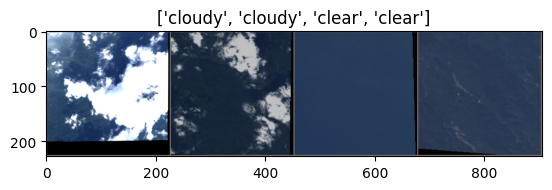

In [21]:
inputs, labels = next(iter(dataloaders['train']))

out = torchvision.utils.make_grid(inputs)

imshow(out, title=[classes[x] for x in labels])

## トレーニング定義

デバイスを取得する（GPU が使えれば GPU 、そうでなければ CPU）

In [22]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

device

device(type='cuda', index=0)

過学習を防ぐため、早期終了を定義する

In [23]:
class EarlyStopping:
    def __init__(self, patience=5, verbose=0):
        self.epoch = 0
        self.pre_loss = float('inf')
        self.patience = patience
        self.verbose = verbose

    def __call__(self, current_loss):
        if self.pre_loss < current_loss:
            self.epoch += 1

            if self.epoch > self.patience:
                if self.verbose:
                    print('early stopping')
                return True

        else:
            self.epoch = 0
            self.pre_loss = current_loss

        return False

誤差、精度の推移をグラフとして保存する

In [24]:
def save_plots(value_dict, label):
    plt.figure(figsize=(10, 7))
    plt.plot(
        value_dict['train'], color='blue', linestyle='-',
        label=f"train {label}"
    )
    plt.plot(
        value_dict['validation'], color='orange', linestyle='-',
        label=f"validation {label}"
    )
    plt.xlabel('Epochs')
    plt.ylabel(label.capitalize())
    plt.legend()
    plt.savefig(f"./{label}.png")

トレーニングを定義する

In [25]:
def train_model(model, criterion, optimizer, early_stopping, num_epochs=25):
    since = time.time()

    loss_dict = {'train': [], 'validation': []}
    acc_dict = {'train': [], 'validation': []}
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    stop = False

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        for phase in ['train', 'validation']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            # トレーニング用データの場合、パラメータを最適化する
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            loss_dict[phase].append(epoch_loss)
            acc_dict[phase].append(epoch_acc.to('cpu').detach().numpy().copy())

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))

            if phase == 'validation':
                # 早期終了の判定
                if early_stopping(epoch_loss):
                    stop = True

                # 最善の状態を保持する
                if epoch_acc > best_acc:
                    best_acc = epoch_acc
                    best_model_wts = copy.deepcopy(model.state_dict())

        if stop:
            break

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    model.load_state_dict(best_model_wts)
    return model, loss_dict, acc_dict

## トレーニング実行

In [26]:
model = model.to(device)

# 損失関数
criterion = nn.CrossEntropyLoss()

# 最適化関数
optimizer = torch.optim.Adam(model.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False)

# 早期終了
early_stopping = EarlyStopping(patience=5, verbose=1)

# トレーニング実行
model, loss_dict, acc_dict = train_model(model, criterion, optimizer, early_stopping, num_epochs=25)

Epoch 0/24
----------
train Loss: 0.5251 Acc: 0.7458
validation Loss: 0.4362 Acc: 0.7800
Epoch 1/24
----------
train Loss: 0.4565 Acc: 0.7767
validation Loss: 0.4530 Acc: 0.7833
Epoch 2/24
----------
train Loss: 0.4391 Acc: 0.8083
validation Loss: 0.4987 Acc: 0.7600
Epoch 3/24
----------
train Loss: 0.4306 Acc: 0.8125
validation Loss: 0.3911 Acc: 0.8033
Epoch 4/24
----------
train Loss: 0.4154 Acc: 0.8125
validation Loss: 0.4079 Acc: 0.8200
Epoch 5/24
----------
train Loss: 0.4395 Acc: 0.7983
validation Loss: 0.3935 Acc: 0.8367
Epoch 6/24
----------
train Loss: 0.4358 Acc: 0.8092
validation Loss: 0.4276 Acc: 0.7967
Epoch 7/24
----------
train Loss: 0.4364 Acc: 0.8017
validation Loss: 0.4531 Acc: 0.8000
Epoch 8/24
----------
train Loss: 0.4400 Acc: 0.8025
validation Loss: 0.4216 Acc: 0.8200
Epoch 9/24
----------
train Loss: 0.4222 Acc: 0.8133
validation Loss: 0.3902 Acc: 0.8100
Epoch 10/24
----------
train Loss: 0.4263 Acc: 0.8283
validation Loss: 0.3521 Acc: 0.8467
Epoch 11/24
--------

モデルを保存する

In [27]:
torch.save(model.state_dict(), "./efficientnet_v2_m.pth")

誤差推移のグラフを保存する

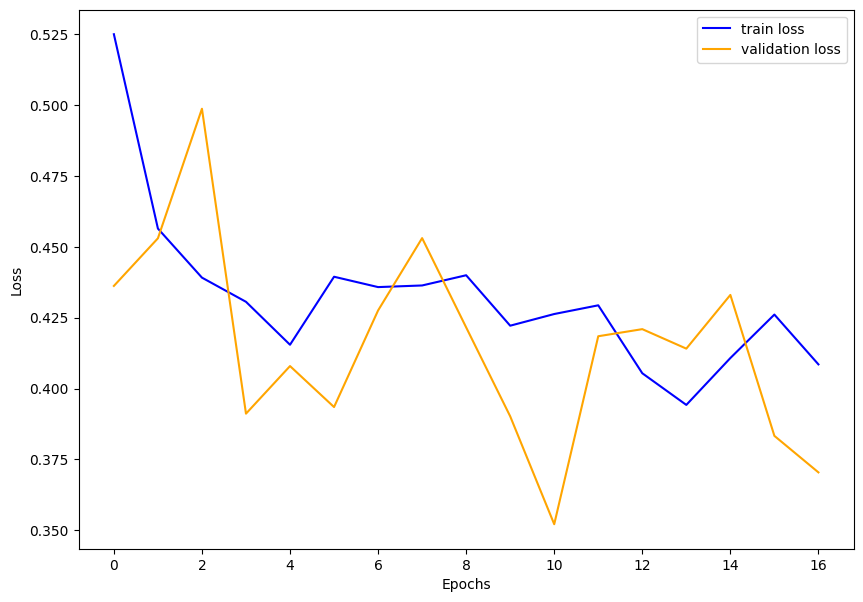

In [28]:
save_plots(loss_dict, "loss")

精度推移のグラフを保存する

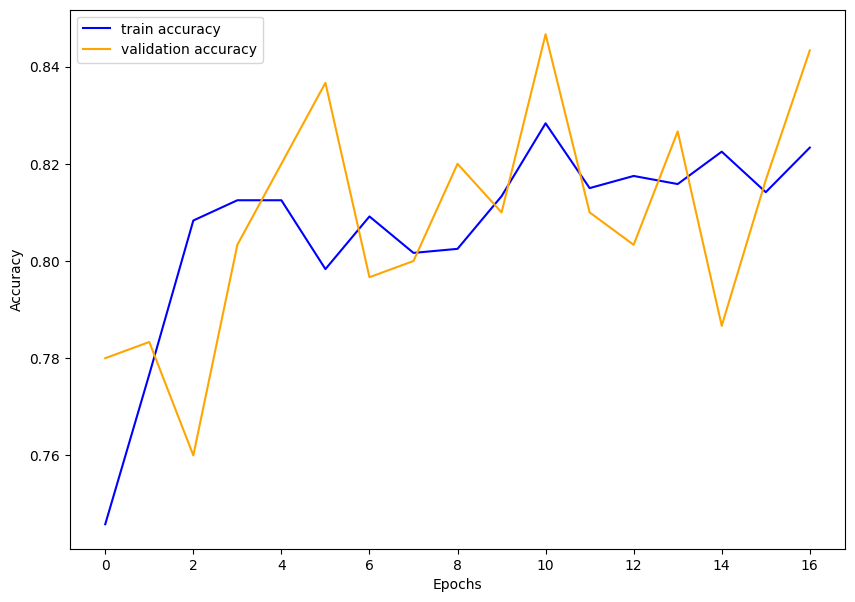

In [29]:
save_plots(acc_dict, "accuracy")

各出力を Google Drive に保存する

In [30]:
!mkdir "./drive/MyDrive/space/model"
!cp "./efficientnet_v2_m.pth" "./drive/MyDrive/space/model/"
!cp "./loss.png" "./drive/MyDrive/space/model/"
!cp "./accuracy.png" "./drive/MyDrive/space/model/"

mkdir: cannot create directory ‘./drive/MyDrive/space/model’: File exists


## 精度検証

In [31]:
def visualize_model(model, dataset, num_images=12):
    model.eval()
    images_so_far = 0
    correct = 0
    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders[dataset]):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                if labels[j] == preds[j]:
                    correct += 1
                images_so_far += 1
                print(f"correct: {classes[labels[j]]}")
                print(f"predicted: {classes[preds[j]]}")
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    return correct / num_images

評価データに対する精度

correct: clear
predicted: clear


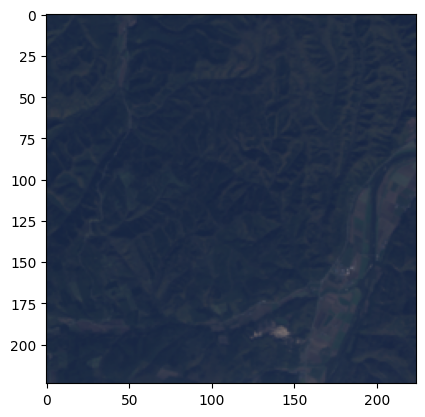

correct: cloudy
predicted: cloudy


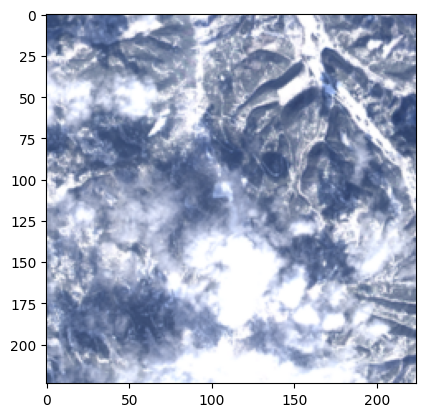

correct: cloudy
predicted: cloudy


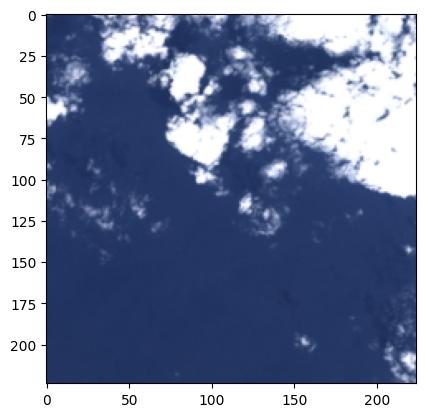

correct: clear
predicted: cloudy


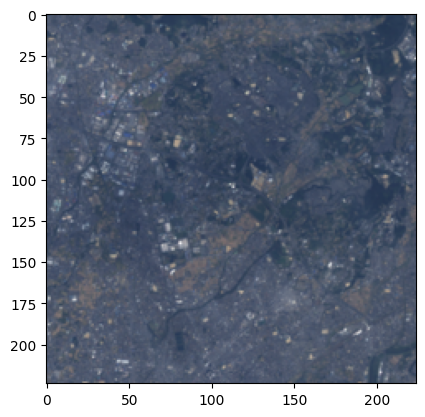

correct: clear
predicted: clear


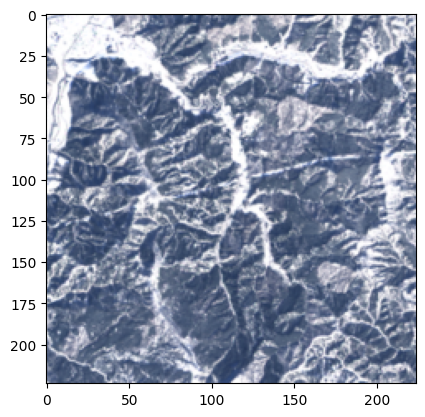

correct: cloudy
predicted: cloudy


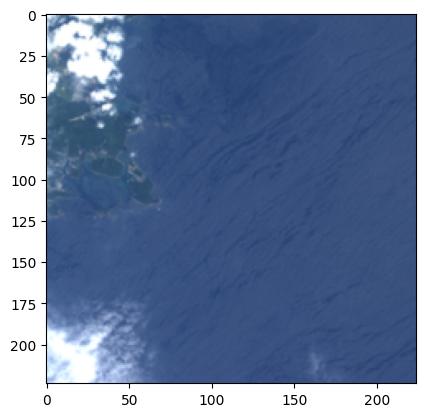

correct: cloudy
predicted: cloudy


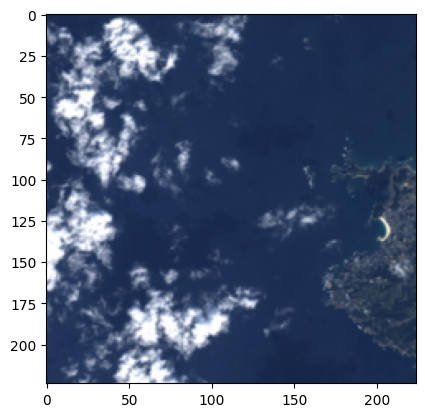

correct: clear
predicted: cloudy


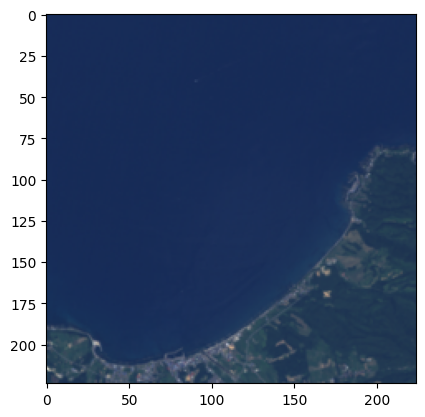

correct: cloudy
predicted: cloudy


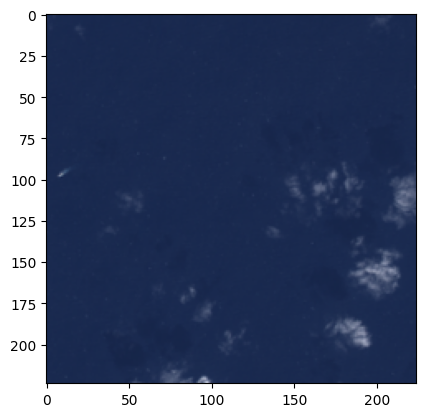

correct: clear
predicted: clear


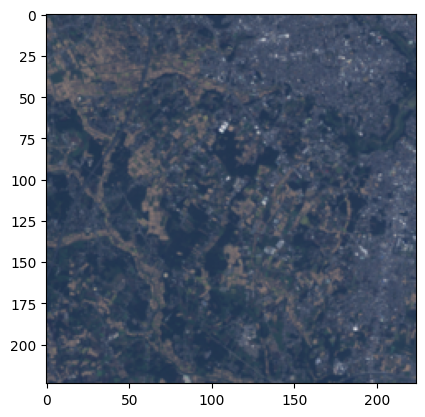

correct: clear
predicted: clear


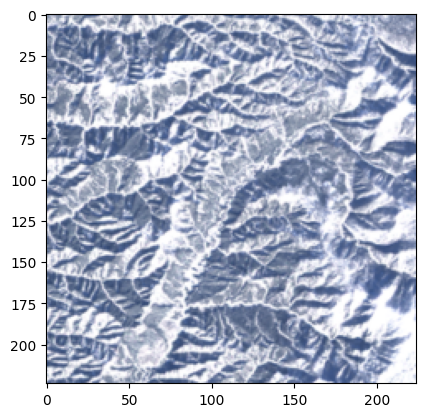

correct: clear
predicted: clear


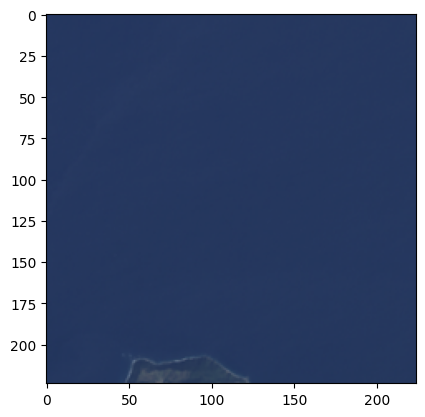

0.8333333333333334

In [32]:
visualize_model(model, "validation")

保存したモデルをロードする

In [33]:
saved_model = models.efficientnet_v2_m()

In [34]:
num_ftrs = saved_model.classifier[1].in_features
saved_model.classifier[1] = nn.Linear(num_ftrs, len(classes))

In [35]:
saved_model.load_state_dict(torch.load("efficientnet_v2_m.pth"))

<All keys matched successfully>

In [36]:
saved_model = saved_model.to(device)

テストデータに対する精度

correct: clear
predicted: clear


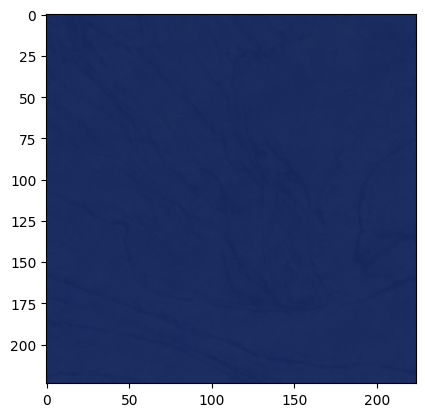

correct: clear
predicted: clear


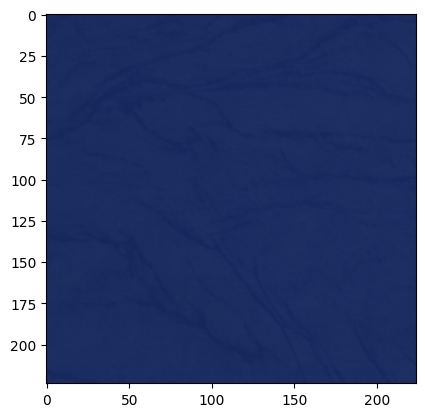

correct: clear
predicted: cloudy


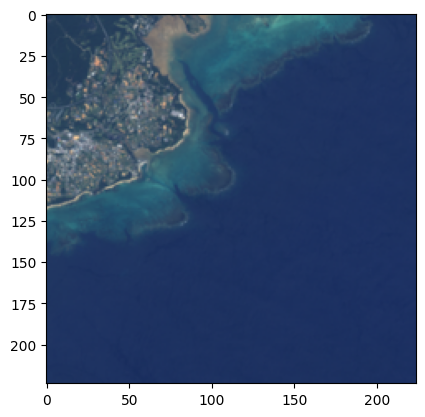

correct: clear
predicted: clear


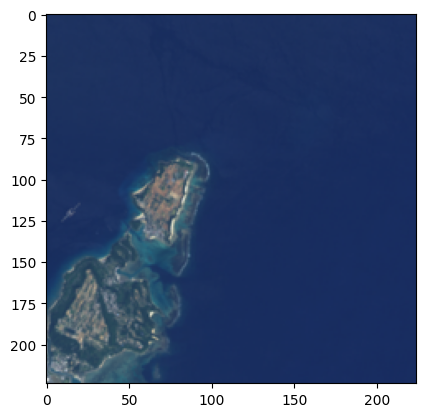

correct: clear
predicted: clear


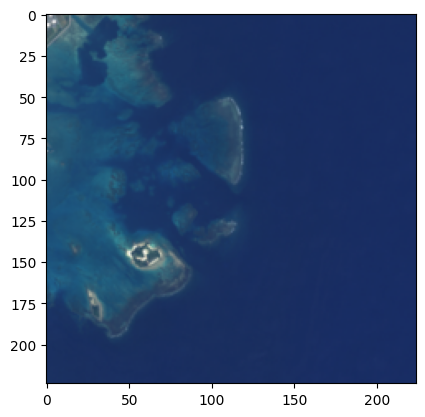

correct: clear
predicted: clear


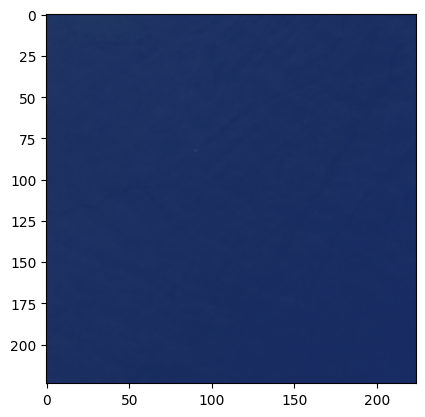

correct: clear
predicted: cloudy


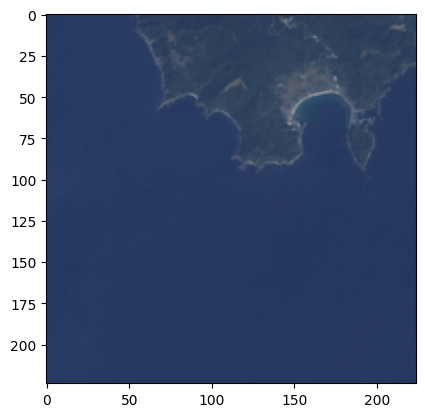

correct: clear
predicted: clear


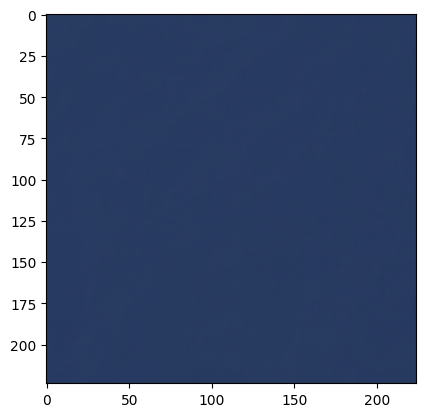

correct: clear
predicted: clear


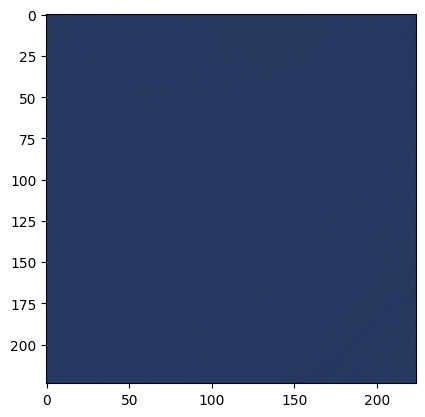

correct: clear
predicted: cloudy


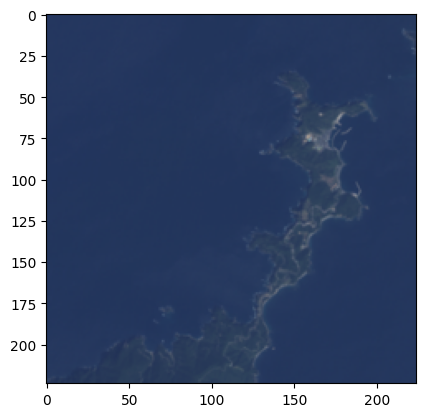

correct: clear
predicted: cloudy


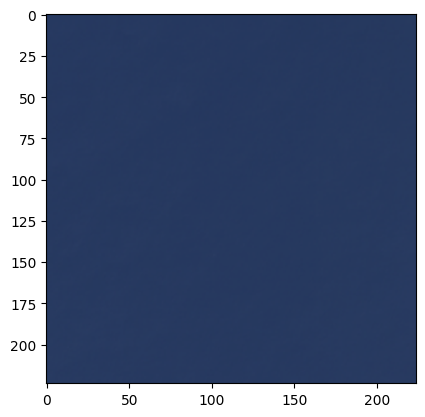

correct: clear
predicted: clear


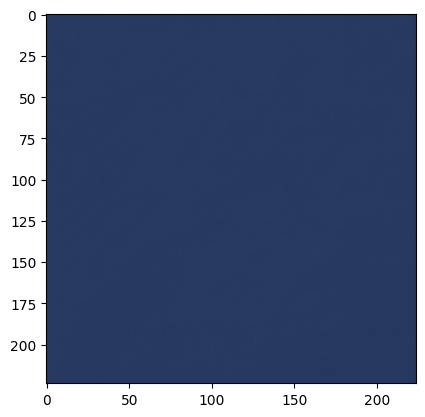

correct: clear
predicted: clear


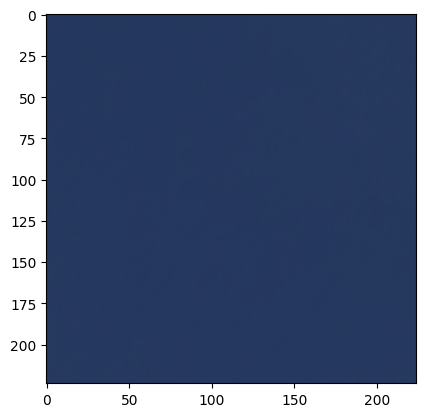

correct: clear
predicted: clear


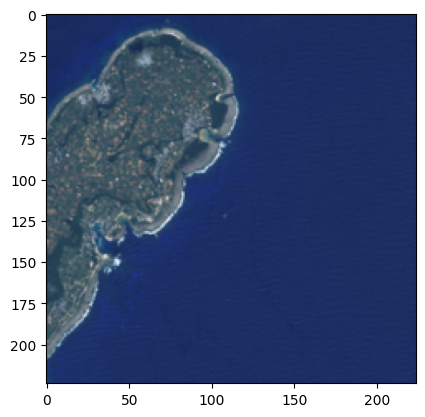

correct: clear
predicted: clear


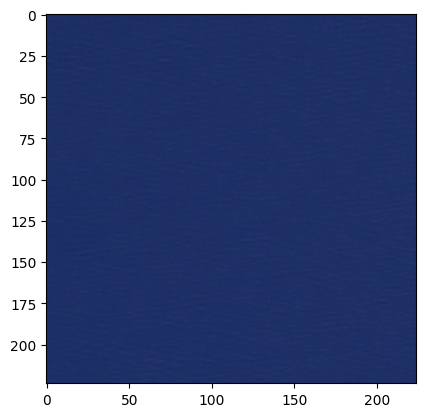

correct: clear
predicted: clear


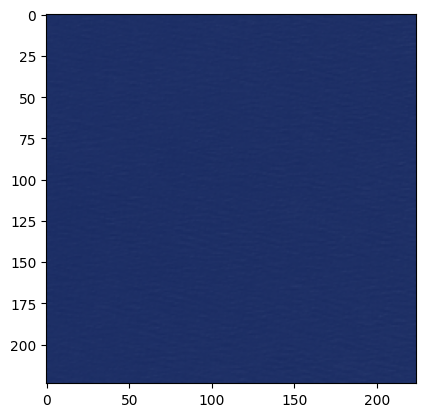

correct: clear
predicted: clear


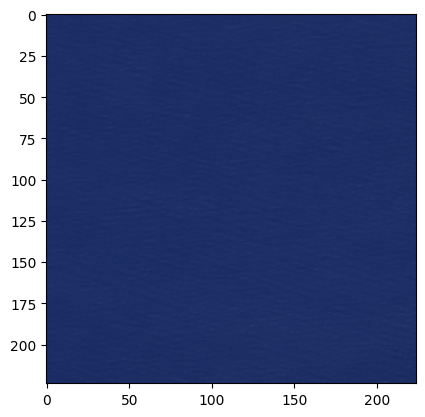

correct: clear
predicted: cloudy


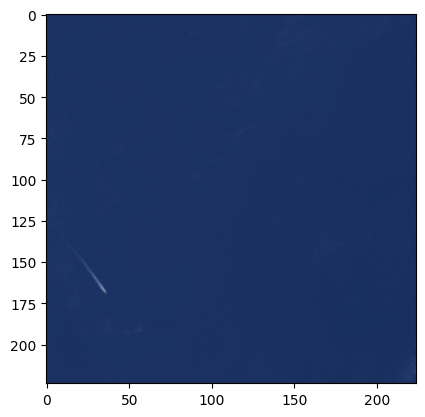

correct: clear
predicted: cloudy


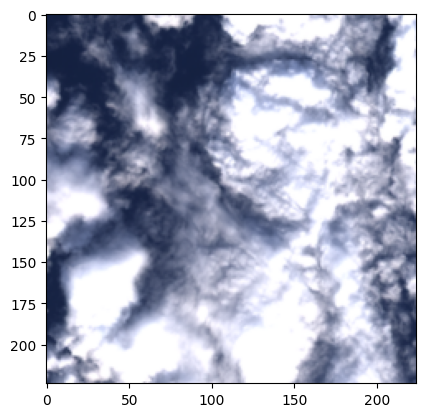

correct: clear
predicted: clear


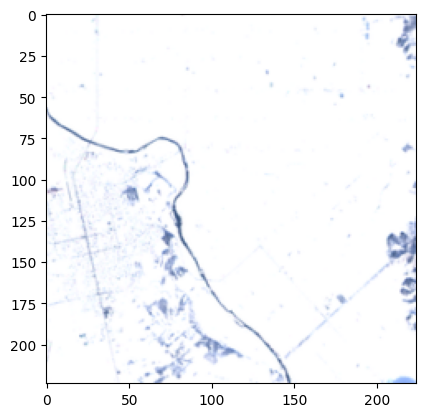

correct: clear
predicted: clear


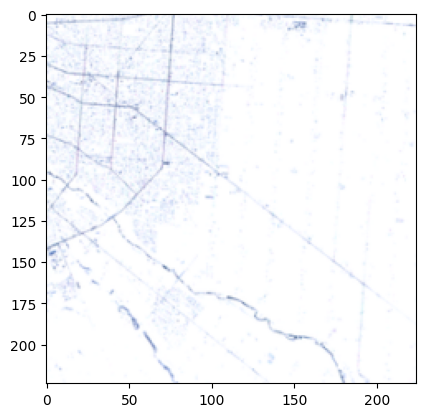

correct: clear
predicted: clear


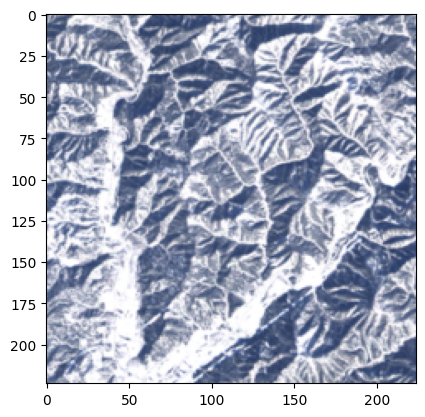

correct: clear
predicted: clear


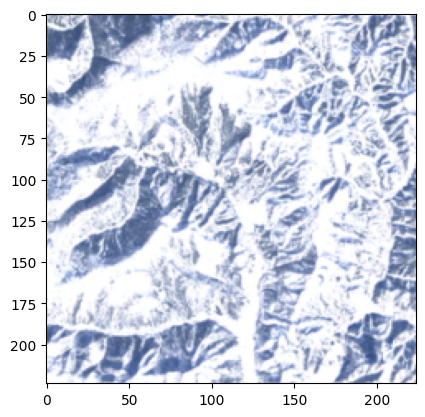

correct: clear
predicted: clear


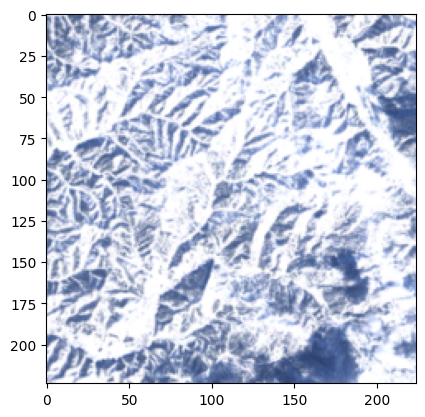

correct: clear
predicted: clear


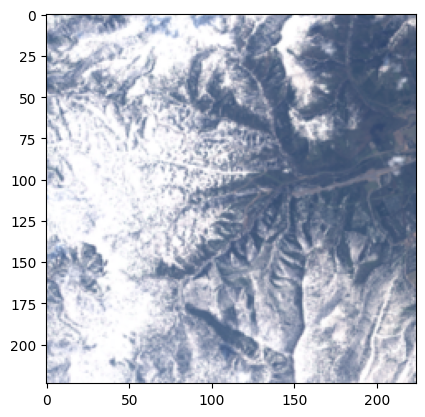

correct: clear
predicted: clear


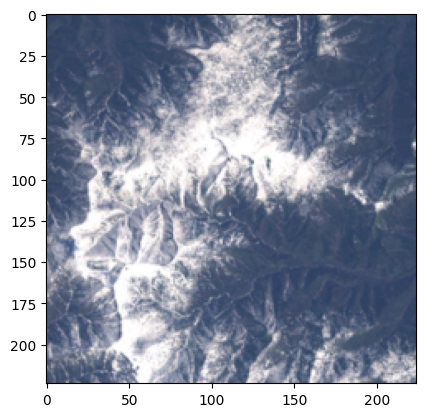

correct: clear
predicted: clear


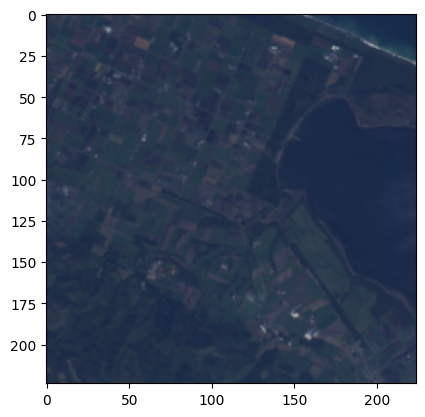

correct: clear
predicted: cloudy


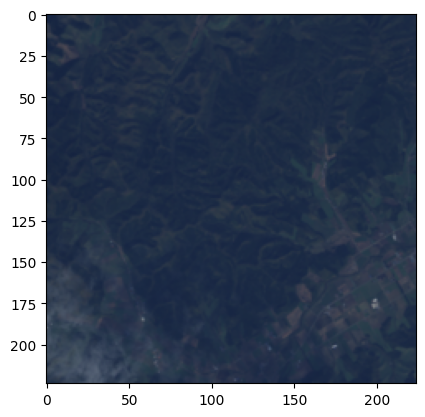

correct: clear
predicted: clear


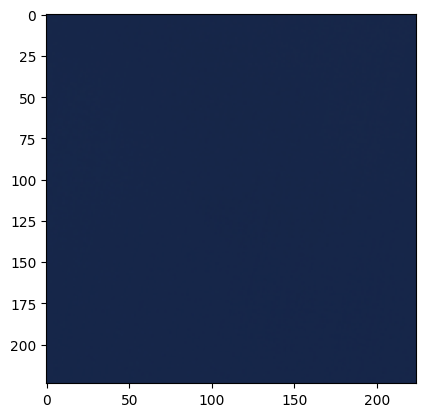

correct: clear
predicted: clear


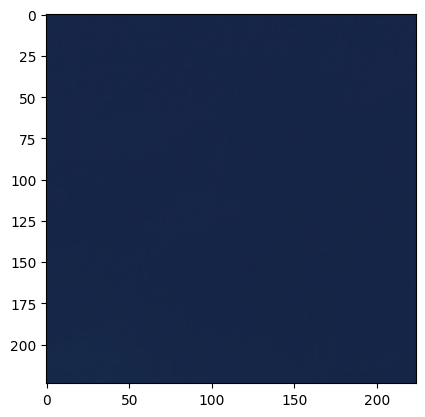

correct: clear
predicted: clear


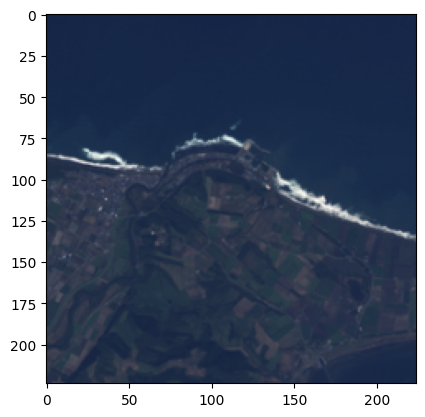

correct: clear
predicted: clear


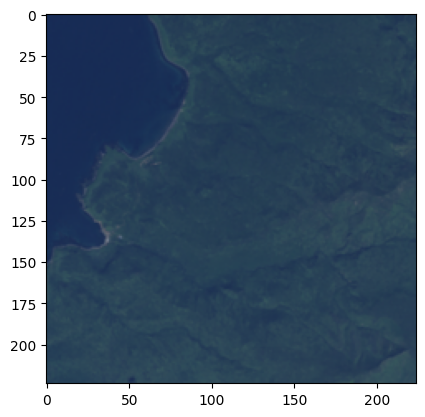

correct: clear
predicted: clear


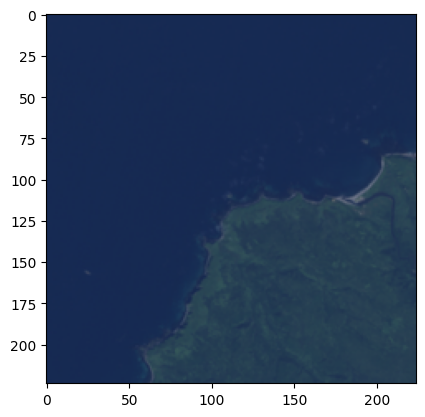

correct: clear
predicted: clear


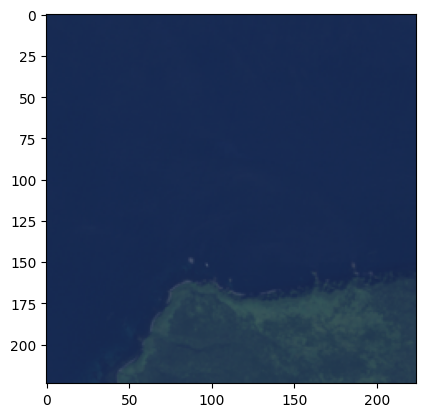

correct: clear
predicted: clear


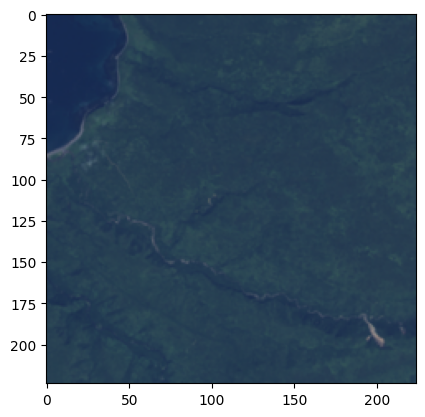

correct: clear
predicted: clear


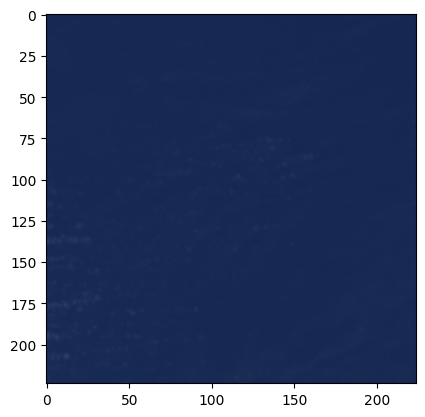

correct: cloudy
predicted: cloudy


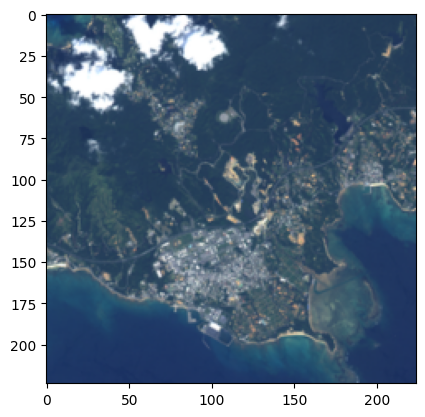

correct: cloudy
predicted: cloudy


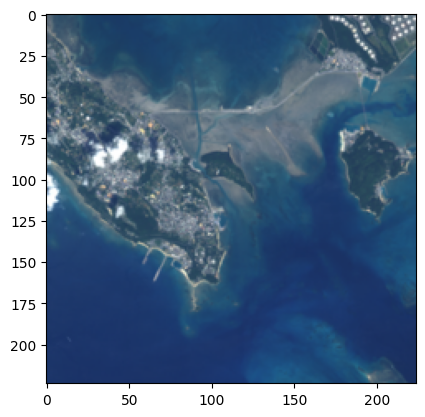

correct: cloudy
predicted: cloudy


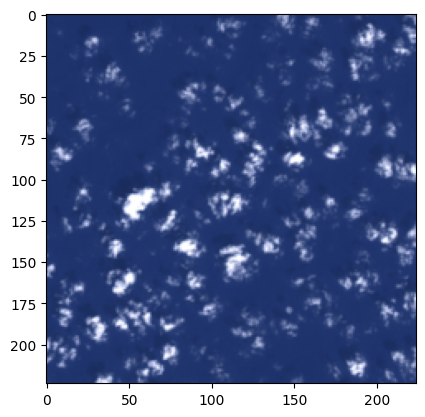

correct: cloudy
predicted: cloudy


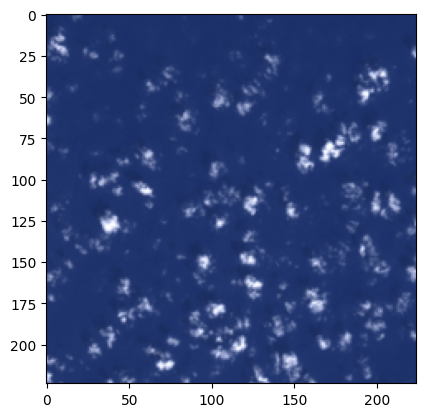

correct: cloudy
predicted: cloudy


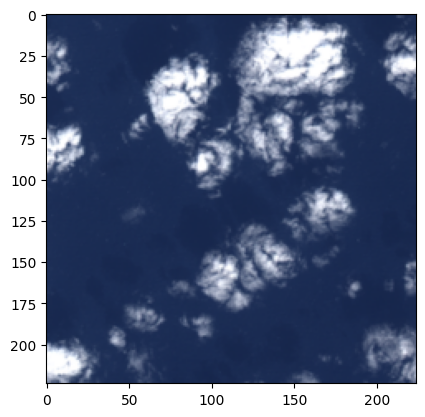

correct: cloudy
predicted: cloudy


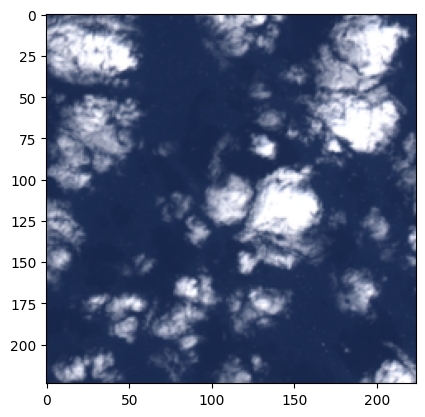

correct: cloudy
predicted: cloudy


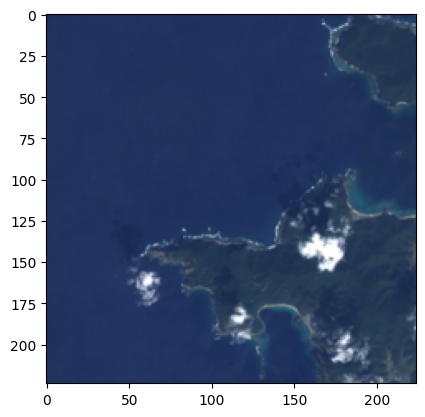

correct: cloudy
predicted: cloudy


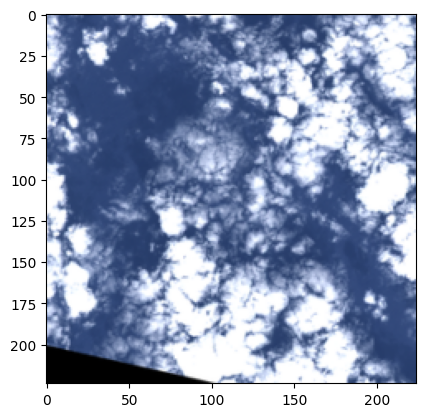

correct: cloudy
predicted: cloudy


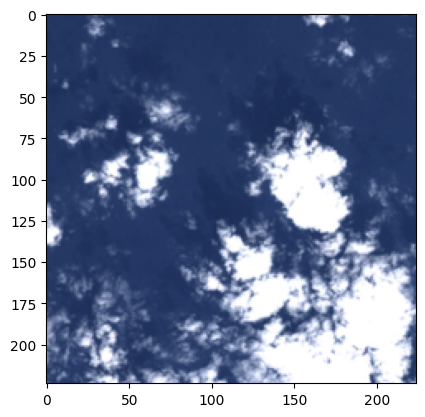

correct: cloudy
predicted: cloudy


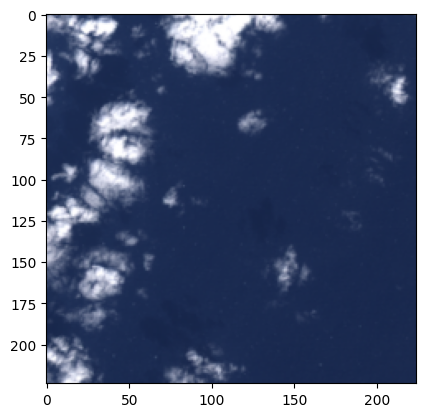

correct: cloudy
predicted: cloudy


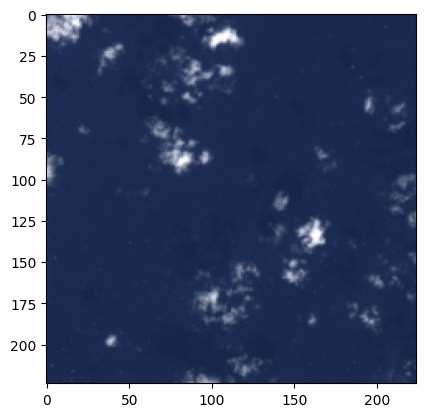

correct: cloudy
predicted: cloudy


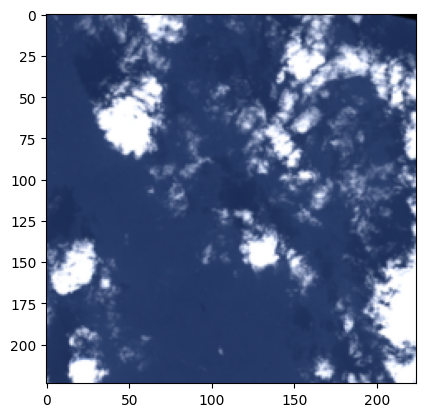

correct: cloudy
predicted: cloudy


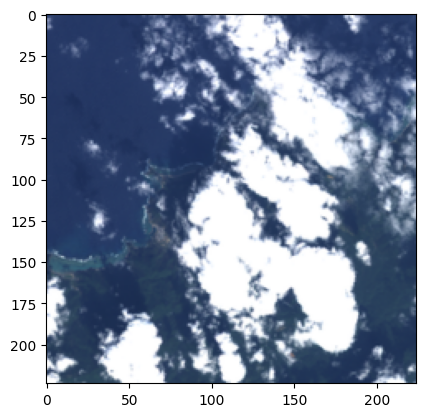

correct: cloudy
predicted: cloudy


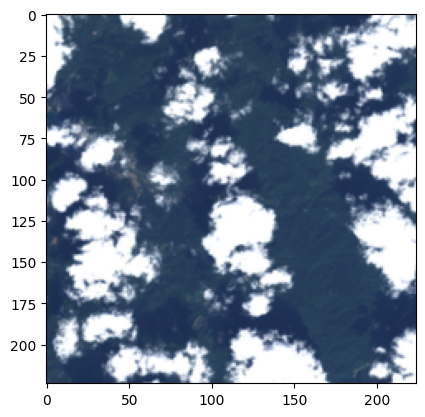

correct: cloudy
predicted: cloudy


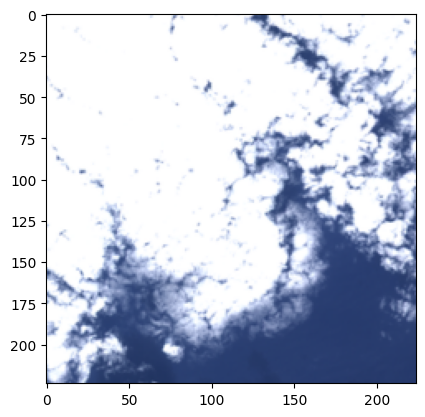

correct: cloudy
predicted: cloudy


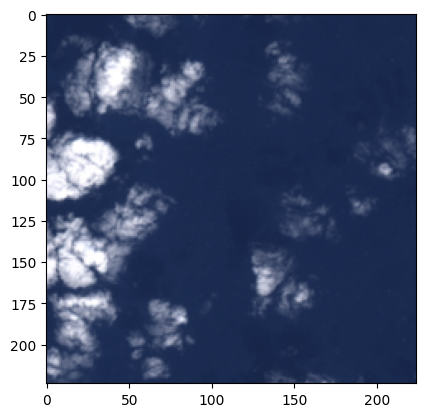

correct: cloudy
predicted: cloudy


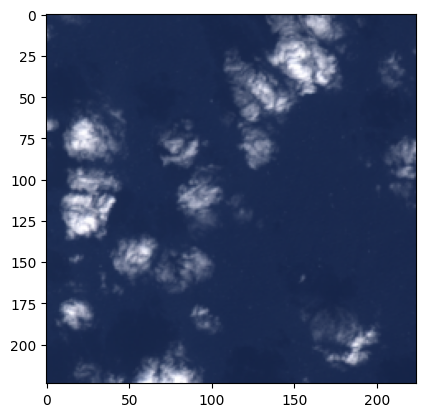

correct: cloudy
predicted: cloudy


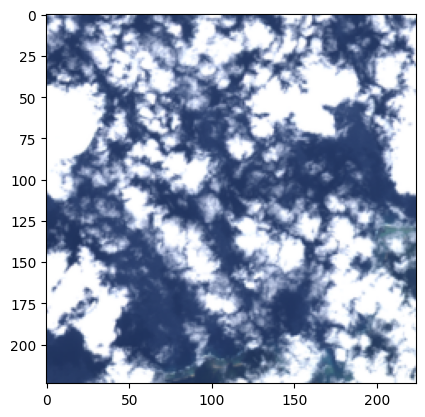

correct: cloudy
predicted: cloudy


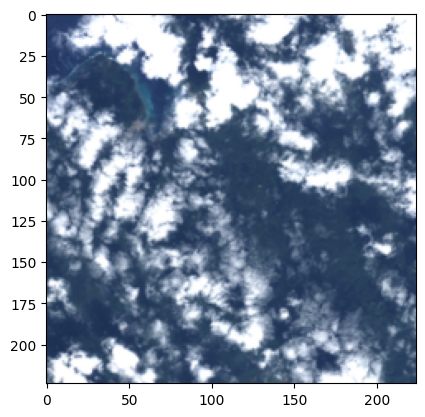

correct: cloudy
predicted: cloudy


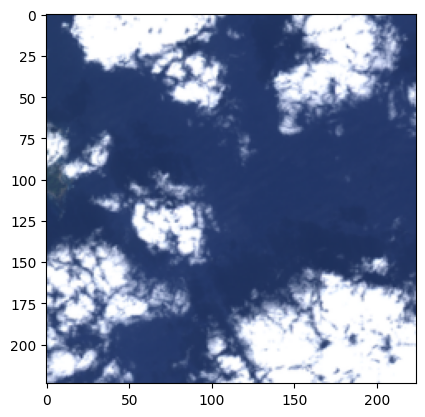

correct: cloudy
predicted: cloudy


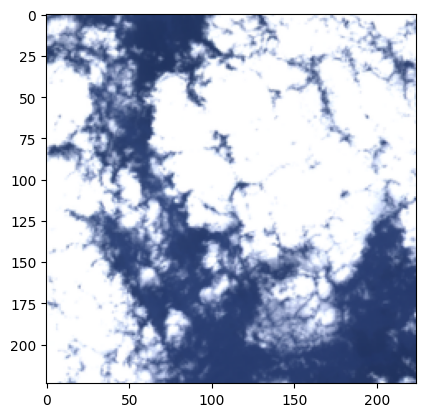

correct: cloudy
predicted: cloudy


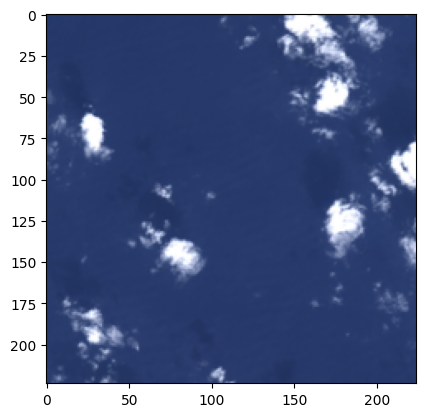

correct: cloudy
predicted: cloudy


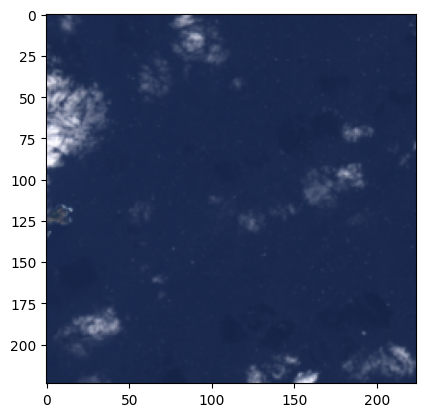

correct: cloudy
predicted: cloudy


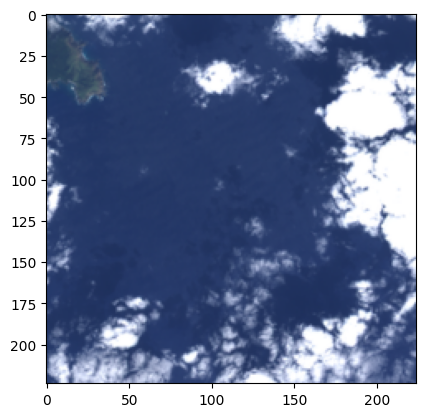

correct: cloudy
predicted: clear


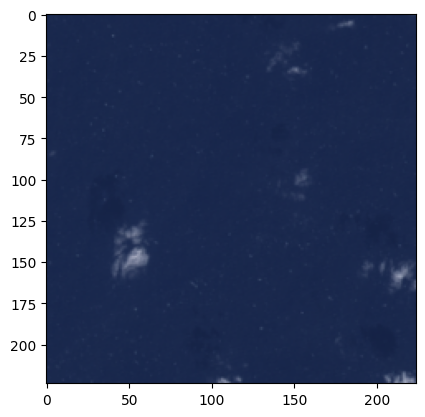

correct: cloudy
predicted: clear


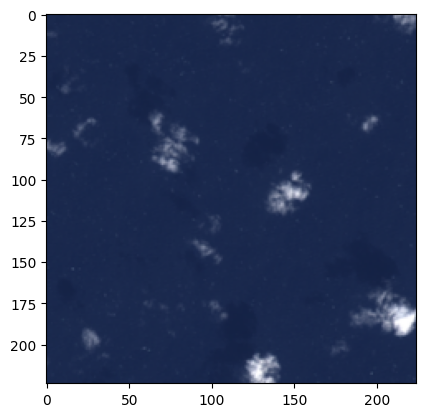

correct: cloudy
predicted: clear


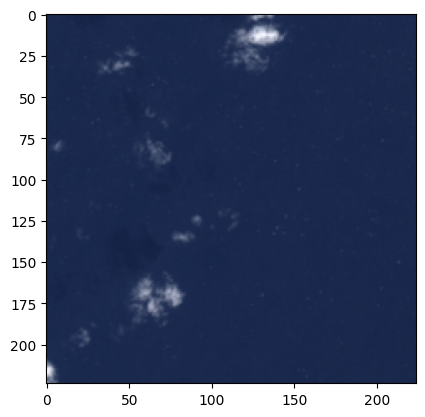

correct: cloudy
predicted: clear


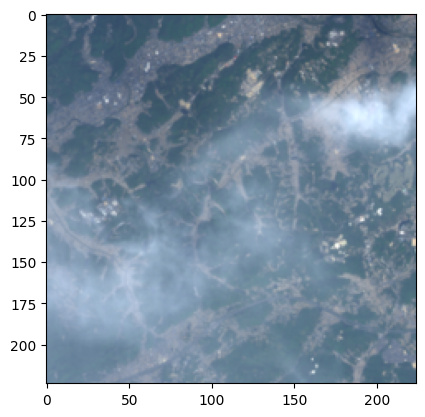

correct: cloudy
predicted: cloudy


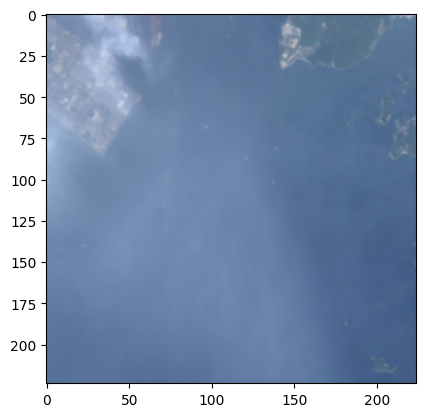

correct: cloudy
predicted: cloudy


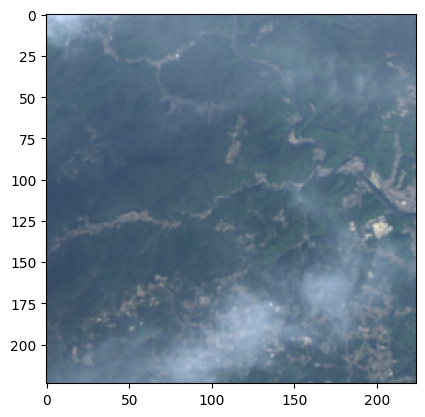

correct: cloudy
predicted: cloudy


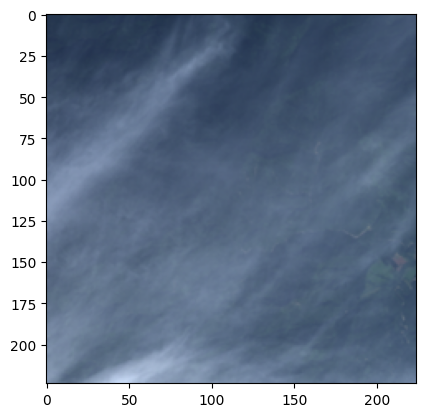

correct: cloudy
predicted: cloudy


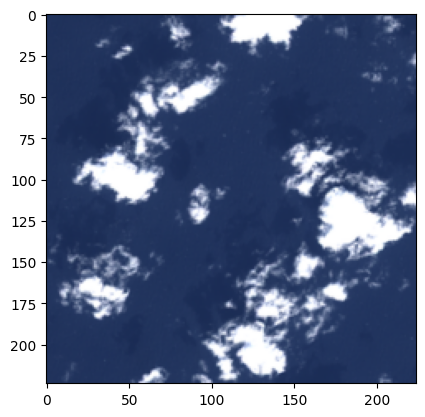

correct: cloudy
predicted: cloudy


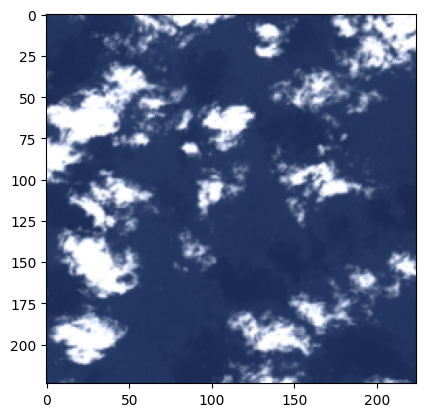

correct: cloudy
predicted: cloudy


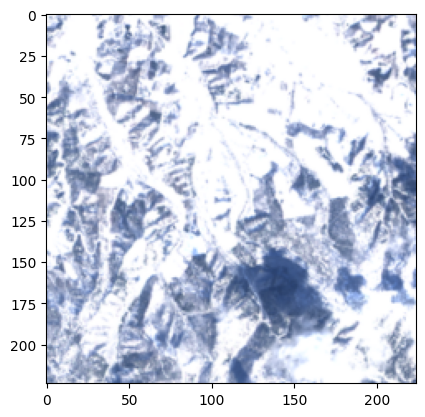

correct: cloudy
predicted: cloudy


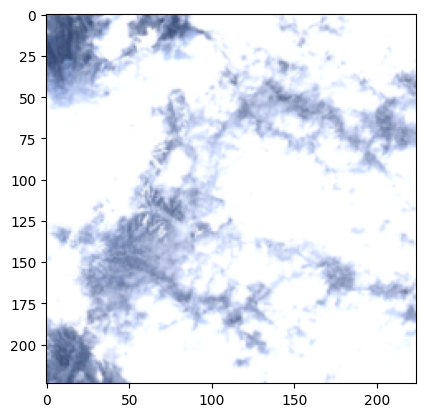

correct: cloudy
predicted: cloudy


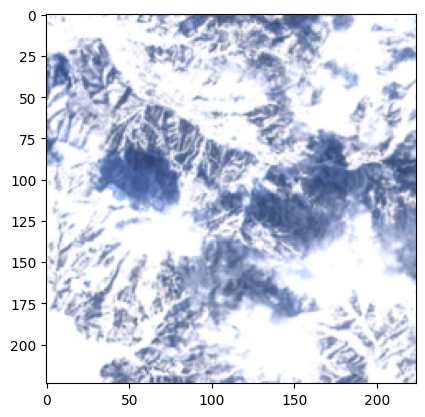

correct: cloudy
predicted: cloudy


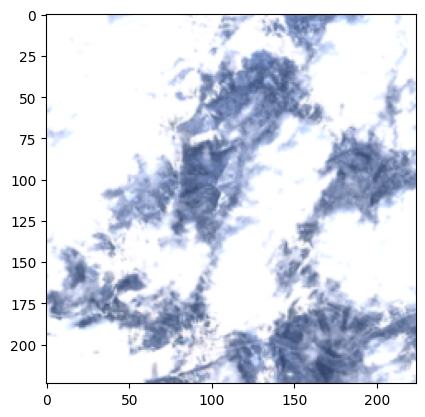

correct: cloudy
predicted: cloudy


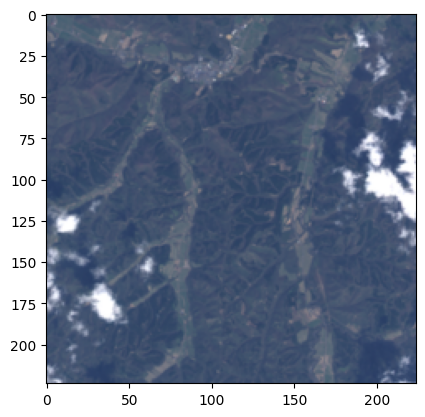

correct: cloudy
predicted: clear


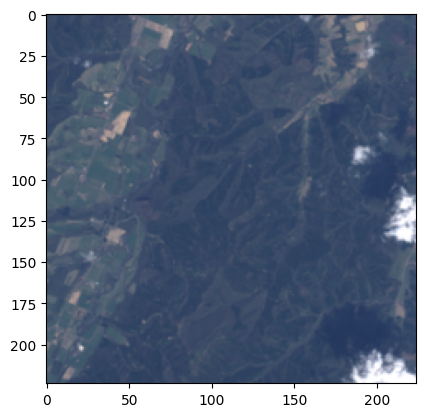

correct: cloudy
predicted: cloudy


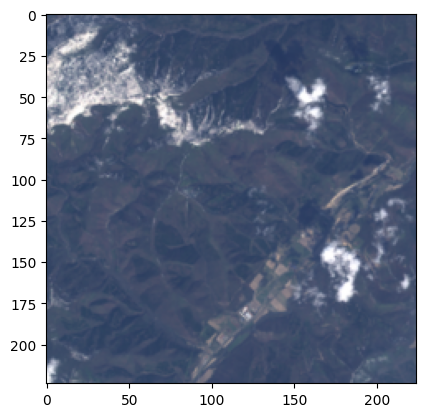

correct: cloudy
predicted: clear


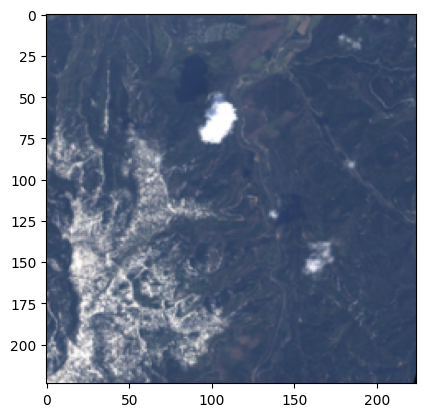

correct: cloudy
predicted: cloudy


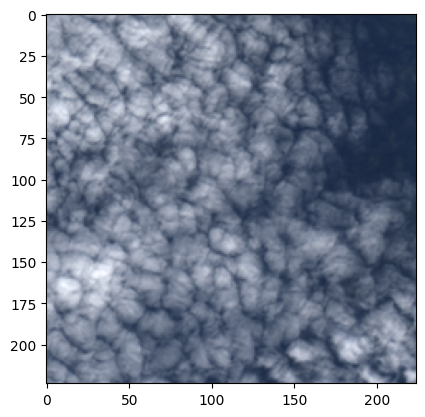

correct: cloudy
predicted: cloudy


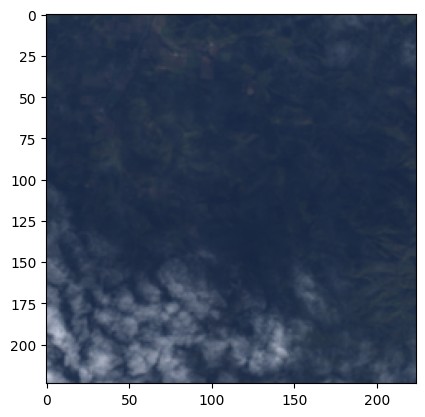

correct: cloudy
predicted: clear


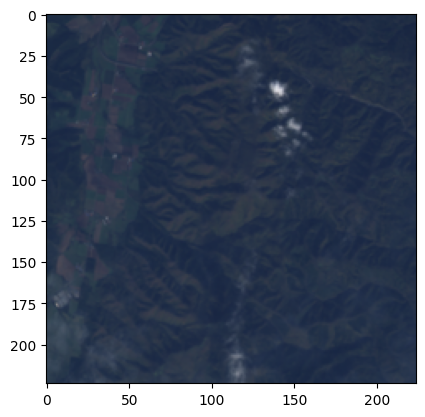

correct: cloudy
predicted: cloudy


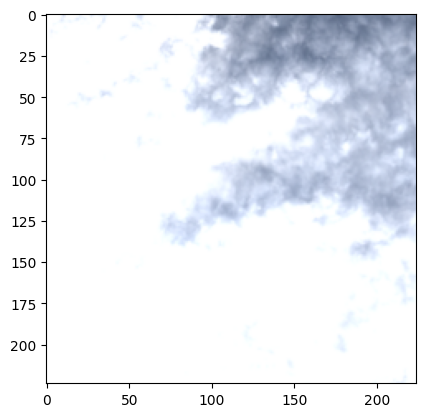

correct: cloudy
predicted: cloudy


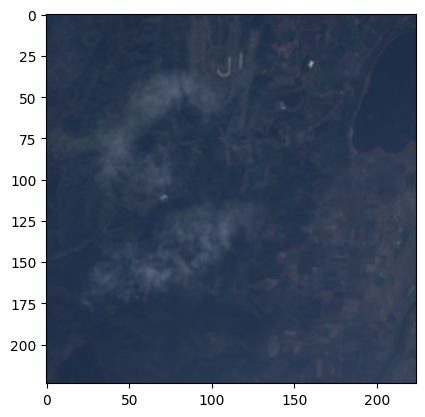

correct: cloudy
predicted: cloudy


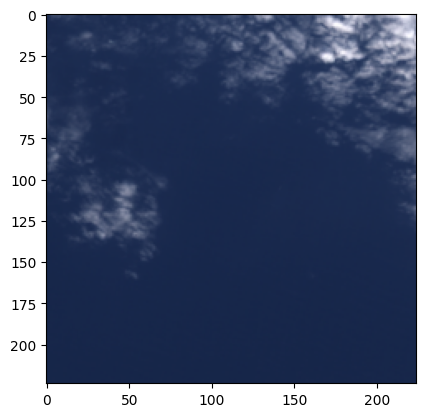

correct: cloudy
predicted: cloudy


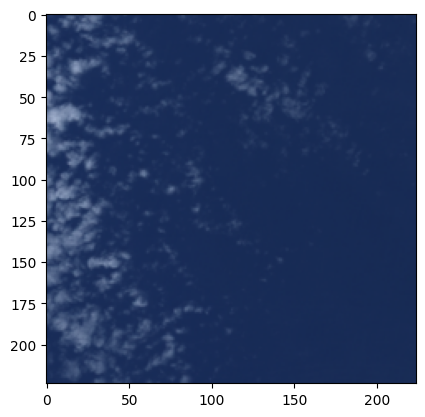

correct: cloudy
predicted: cloudy


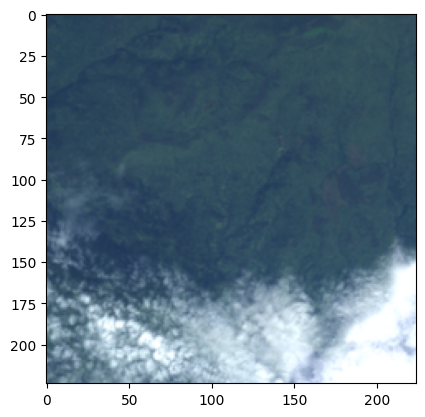

correct: cloudy
predicted: cloudy


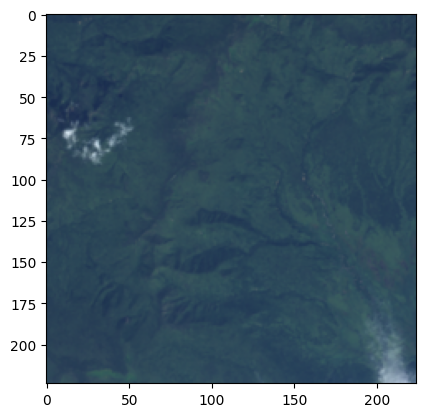

correct: cloudy
predicted: cloudy


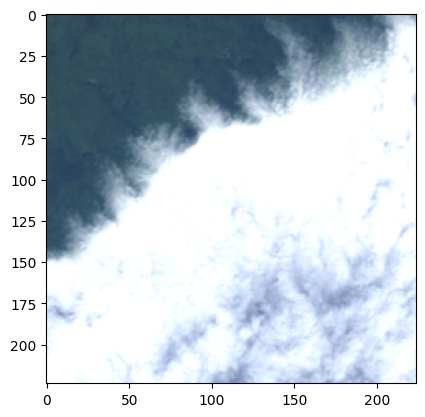

correct: cloudy
predicted: clear


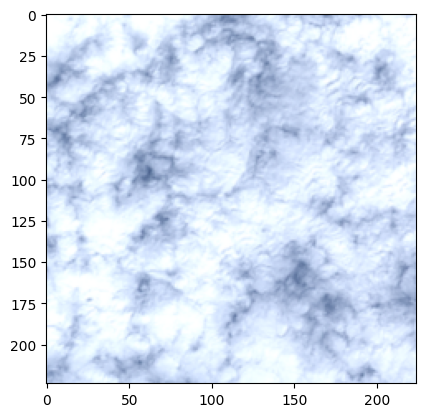

correct: cloudy
predicted: cloudy


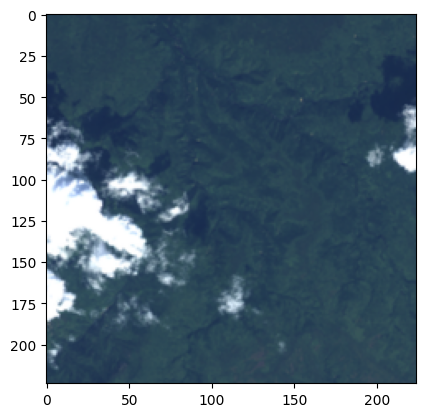

correct: cloudy
predicted: cloudy


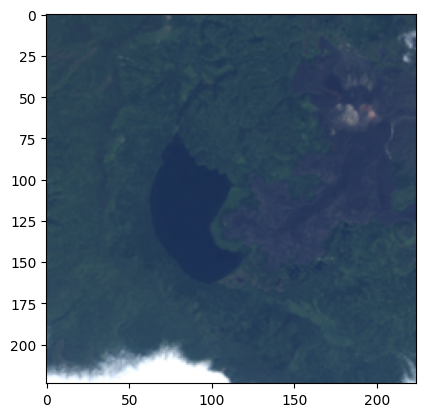

correct: cloudy
predicted: cloudy


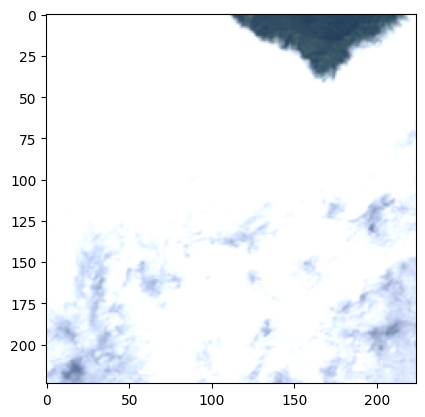

correct: cloudy
predicted: cloudy


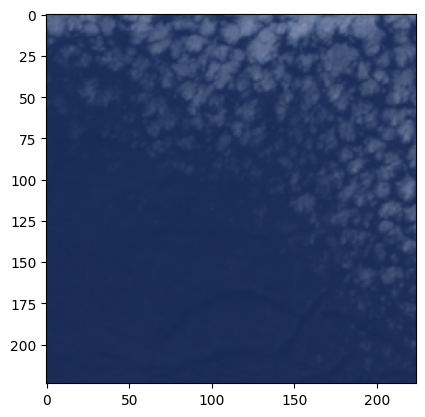

correct: cloudy
predicted: cloudy


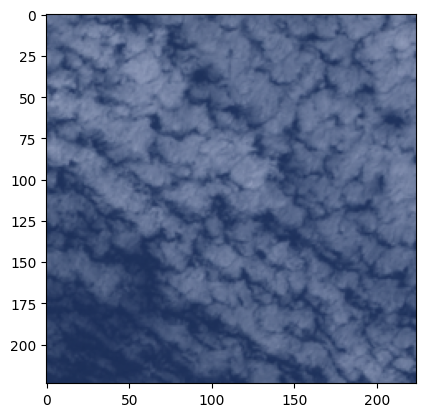

correct: cloudy
predicted: cloudy


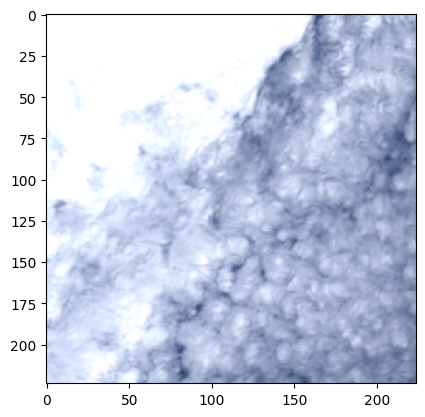

correct: cloudy
predicted: cloudy


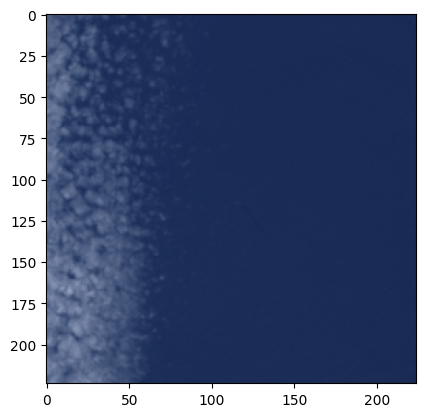

correct: cloudy
predicted: cloudy


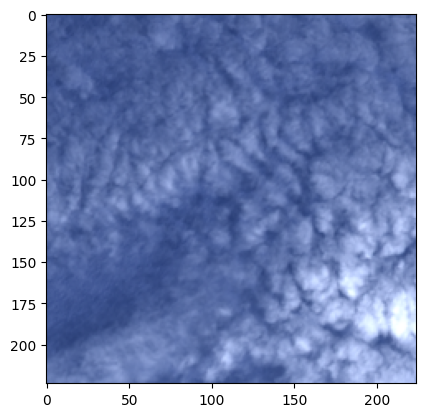

correct: cloudy
predicted: cloudy


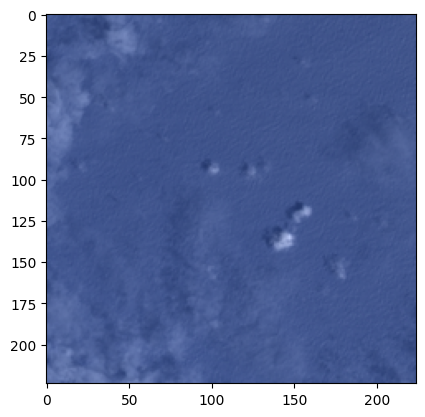

correct: cloudy
predicted: cloudy


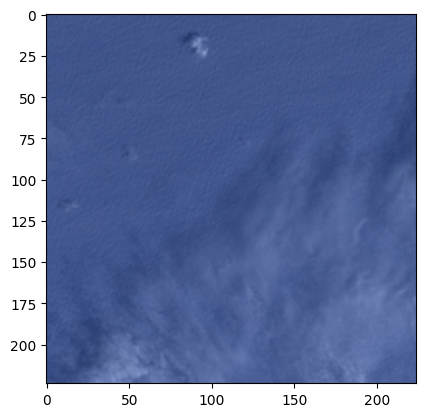

correct: cloudy
predicted: cloudy


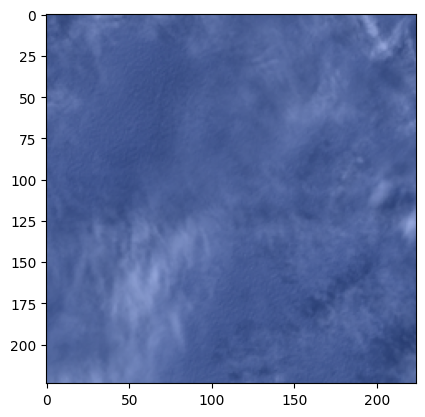

correct: cloudy
predicted: cloudy


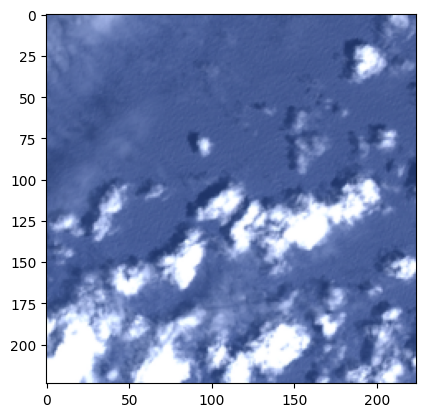

0.85

In [37]:
visualize_model(saved_model, "test", 100)

## ONNX 形式への変換

In [39]:
import onnx

onnx_file = "efficientnet_v2_m.onnx"

dummy_img = torch.zeros(1, 3, 224, 224)

cpu_device = torch.device("cpu")

cpu_model = saved_model.to(cpu_device)
dummy_img.to(cpu_device)

torch.onnx.export(cpu_model, dummy_img, onnx_file, verbose=False, opset_version=12, input_names=['images'],
                  output_names=['predictions'],
                  dynamic_axes={'images': {0: 'batch_size'},})

onnx_model = onnx.load(onnx_file)
onnx.checker.check_model(onnx_model)

============= Diagnostic Run torch.onnx.export version 2.0.1+cu118 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



In [40]:
!cp "./efficientnet_v2_m.onnx" "./drive/MyDrive/space/model/"